# *Detecting deforestation using Deep Learning*

Author@Japheth_Kimeu

Date: Jan, 2023

Data: Sentinel-2 image chips with corresponding masks 

In [1]:
import numpy as np 
import pandas as pd 
import tensorflow as tf
from tensorflow.keras.layers import Input
from tensorflow.keras.applications import MobileNetV2
#import keras.backend as K
from tensorflow.keras import backend as K
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import os
import cv2

2024-10-24 16:21:46.969913: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-24 16:21:46.979514: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-24 16:21:46.990328: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-24 16:21:46.993343: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-24 16:21:47.001627: I tensorflow/core/platform/cpu_feature_guar

In [2]:
print(K.backend())


tensorflow


In [3]:
pip show tensorflow keras


Name: tensorflow
Version: 2.17.0
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /home/luci/.local/lib/python3.10/site-packages
Requires: absl-py, astunparse, flatbuffers, gast, google-pasta, grpcio, h5py, keras, libclang, ml-dtypes, numpy, opt-einsum, packaging, protobuf, requests, setuptools, six, tensorboard, tensorflow-io-gcs-filesystem, termcolor, typing-extensions, wrapt
Required-by: 
---
Name: keras
Version: 3.6.0
Summary: Multi-backend Keras.
Home-page: https://github.com/keras-team/keras
Author: Keras team
Author-email: keras-users@googlegroups.com
License: Apache License 2.0
Location: /home/luci/.local/lib/python3.10/site-packages
Requires: absl-py, h5py, ml-dtypes, namex, numpy, optree, packaging, rich
Required-by: tensorflow
Note: you may need to restart the kernel to use updated packages.


In [4]:
dir0 = './dataset/images'
dir1 = './dataset/masks'

Create dataframe for training, validation and testing datasets

In [5]:
# files=[]
# paths = []
# for dirname, _, filenames in os.walk(dir0):
#     for filename in filenames:
#         path = os.path.join(dirname, filename)    
#         paths.append(path)
#         files.append(filename)

files = []
image_path = []
for dirname, _, filenames in os.walk(dir0):
    for filename in filenames:
        path = os.path.join(dirname, filename)    
        image_path.append(path)
        
        file = filename.split(".")[0]
        files.append(file)

d = {"id": files, "image_path": image_path}
df = pd.DataFrame(data = d)
df = df.set_index('id')
df

,image_path
id,
205_prev_dev,./dataset/images/205_prev_dev.png
9,./dataset/images/9.png
397_Balak,./dataset/images/397_Balak.png
8_Jovtneve,./dataset/images/8_Jovtneve.png
168_IvanoFrank,./dataset/images/168_IvanoFrank.png
...,...
175_IvanoFrank,./dataset/images/175_IvanoFrank.png
23,./dataset/images/23.png
160,./dataset/images/160.png


In [6]:
# mfiles=[]
# mpaths = []
# for dirname, _, filenames in os.walk(dir1):
#     for filename in filenames:
#         path = os.path.join(dirname, filename)    
#         mpaths.append(path)
#         mfiles.append(filename)

mfiles = []
mask_path = []
for dirname, _, filenames in os.walk(dir1):
    for filename in filenames:
        path = os.path.join(dirname, filename)
        mask_path.append(path)
        
        mfile = filename.split(".")[0]
       # car_id = car_id.split("_mask")[0]
        mfiles.append(mfile)

        
d = {"id": mfiles,"mask_path": mask_path}
mask_df = pd.DataFrame(data = d)
mask_df = mask_df.set_index('id')
mask_df

,mask_path
id,
205_prev_dev,./dataset/masks/205_prev_dev.png
9,./dataset/masks/9.png
397_Balak,./dataset/masks/397_Balak.png
8_Jovtneve,./dataset/masks/8_Jovtneve.png
168_IvanoFrank,./dataset/masks/168_IvanoFrank.png
...,...
175_IvanoFrank,./dataset/masks/175_IvanoFrank.png
23,./dataset/masks/23.png
160,./dataset/masks/160.png


Lets look at our images and masks

(512, 512)


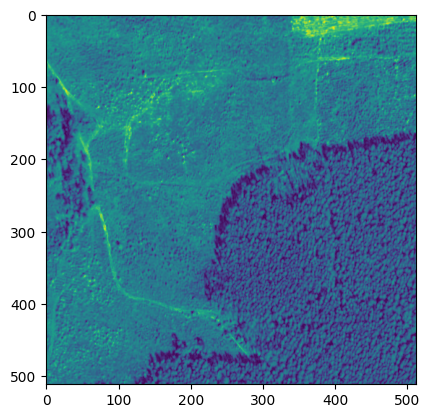

(512, 512)


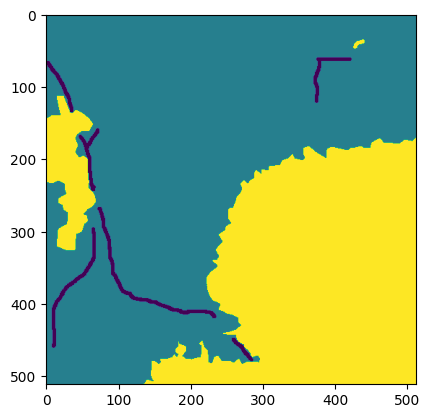

In [7]:
import cv2
path0='./dataset/images/1.png'
img0=cv2.imread(path0,cv2.IMREAD_GRAYSCALE)
shape0=img0.shape
print(shape0)
plt.imshow(img0)
plt.show()

path1='./dataset/masks/1.png'
img1=cv2.imread(path1,cv2.IMREAD_GRAYSCALE)
shape1=img1.shape
print(shape1)
plt.imshow(img1)
plt.show()

In [8]:
# df0=pd.DataFrame(columns=['file','path','mpath','class'])
# df0['file']=files
# df0['path']=paths
# df0['mpath']=mpaths
# df0['class']=1

# display(df0)
# df0.sample(frac=1)

df["mask_path"] = mask_df["mask_path"]
df

,image_path,mask_path
id,,
205_prev_dev,./dataset/images/205_prev_dev.png,./dataset/masks/205_prev_dev.png
9,./dataset/images/9.png,./dataset/masks/9.png
397_Balak,./dataset/images/397_Balak.png,./dataset/masks/397_Balak.png
8_Jovtneve,./dataset/images/8_Jovtneve.png,./dataset/masks/8_Jovtneve.png
168_IvanoFrank,./dataset/images/168_IvanoFrank.png,./dataset/masks/168_IvanoFrank.png
...,...,...
175_IvanoFrank,./dataset/images/175_IvanoFrank.png,./dataset/masks/175_IvanoFrank.png
23,./dataset/images/23.png,./dataset/masks/23.png
160,./dataset/images/160.png,./dataset/masks/160.png


In [9]:
n = len(df)
print(n)
test_df = df.iloc[(n//10)*3:(n//10)*4]
print(test_df)

322
                                             image_path  \
id                                                        
83                              ./dataset/images/83.png   
114_IvanoFrank      ./dataset/images/114_IvanoFrank.png   
128                            ./dataset/images/128.png   
102_IvanoFrank      ./dataset/images/102_IvanoFrank.png   
123_IvanoFrank      ./dataset/images/123_IvanoFrank.png   
112_IvanoFrank      ./dataset/images/112_IvanoFrank.png   
134_IvanoFrank_2  ./dataset/images/134_IvanoFrank_2.png   
58_Jovtneve            ./dataset/images/58_Jovtneve.png   
191_Balak                ./dataset/images/191_Balak.png   
120_IvanoFrank_2  ./dataset/images/120_IvanoFrank_2.png   
96                              ./dataset/images/96.png   
116_Balak                ./dataset/images/116_Balak.png   
137_IvanoFrank      ./dataset/images/137_IvanoFrank.png   
29                              ./dataset/images/29.png   
69_Jovtneve            ./dataset/images/69_Jovtneve.

**Preprocess data**

We apply data augmentations and process our dataset

In [36]:
img_size = [512,512]

def data_augmentation(car_img, mask_img):
    if tf.random.uniform(()) > 0.5:
        car_img = tf.image.flip_left_right(car_img)
        mask_img = tf.image.flip_left_right(mask_img)

    return car_img, mask_img

# Define the desired image size
img_size = (256, 256)  # Adjust this based on your requirement

def preprocessing(image_path, mask_path):
    # Load and preprocess the car image
    car_img = tf.io.read_file(image_path) 
    car_img = tf.image.decode_png(car_img, channels=3)
    car_img = tf.image.resize(car_img, img_size)
    car_img = tf.cast(car_img, tf.float32) / 255.0  # Normalize to [0, 1]

    # Load and preprocess the mask image
    mask_img = tf.io.read_file(mask_path)
    mask_img = tf.image.decode_png(mask_img, channels=1)  # Read mask as a single channel
    mask_img = tf.image.resize(mask_img, img_size)  # Resize to match car image size
    
    # Convert the mask to binary without changing values
    # Assume the mask is already in a suitable format (0 and 255)
    mask_img = tf.cast(mask_img, tf.float32) / 255.0  # Normalize to [0, 1]

    return car_img, mask_img

def create_dataset(df, train = False):
    if not train:
        ds = tf.data.Dataset.from_tensor_slices((df["image_path"].values, df["mask_path"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
    else:
        ds = tf.data.Dataset.from_tensor_slices((df["image_path"].values, df["mask_path"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
        ds = ds.map(data_augmentation, tf.data.AUTOTUNE)

    return ds

In [37]:
train_df, valid_df = train_test_split(df, test_size=0.2)
train = create_dataset(train_df)
valid = create_dataset(valid_df)
test = create_dataset(test_df)

In [38]:
print(train)

<_ParallelMapDataset element_spec=(TensorSpec(shape=(256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(256, 256, 1), dtype=tf.float32, name=None))>


In [39]:
dataset_list = list(train.take(5))  # Take a few examples

for example in dataset_list:
    print(example)


(<tf.Tensor: shape=(256, 256, 3), dtype=float32, numpy=
array([[[0.23431373, 0.33235294, 0.45      ],
        [0.17156863, 0.27156863, 0.38627452],
        [0.04607843, 0.14607844, 0.25588235],
        ...,
        [0.15490197, 0.27156863, 0.3735294 ],
        [0.21078432, 0.31176472, 0.4127451 ],
        [0.16764706, 0.2617647 , 0.35588235]],

       [[0.14803922, 0.24607843, 0.34607843],
        [0.09803922, 0.19803922, 0.29313725],
        [0.09019608, 0.19411765, 0.2872549 ],
        ...,
        [0.22254902, 0.3245098 , 0.42058823],
        [0.17352942, 0.26764706, 0.3617647 ],
        [0.14019608, 0.22058824, 0.31176472]],

       [[0.05882353, 0.15686275, 0.23921569],
        [0.06960785, 0.15784314, 0.24313726],
        [0.00882353, 0.09607843, 0.18333334],
        ...,
        [0.19215687, 0.2764706 , 0.37156862],
        [0.19313726, 0.27450982, 0.35980392],
        [0.1509804 , 0.22058824, 0.3009804 ]],

       ...,

       [[0.24705882, 0.38235295, 0.4392157 ],
        [0.2

2024-10-24 16:25:09.143001: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [40]:
TRAIN_LENGTH = len(train_df)
BATCH_SIZE = 8
BUFFER_SIZE = 100

In [61]:
train_dataset = train.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset = train_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
valid_dataset = valid.batch(BATCH_SIZE)
test_dataset = test.batch(BATCH_SIZE)

In [62]:
print(train_dataset)

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None))>


In [63]:
print(TRAIN_LENGTH)

257


In [64]:
def display(display_list):
    plt.figure(figsize=(12,12))
    title = ['Input Image','True Mask','Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

2024-10-24 16:27:50.155289: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


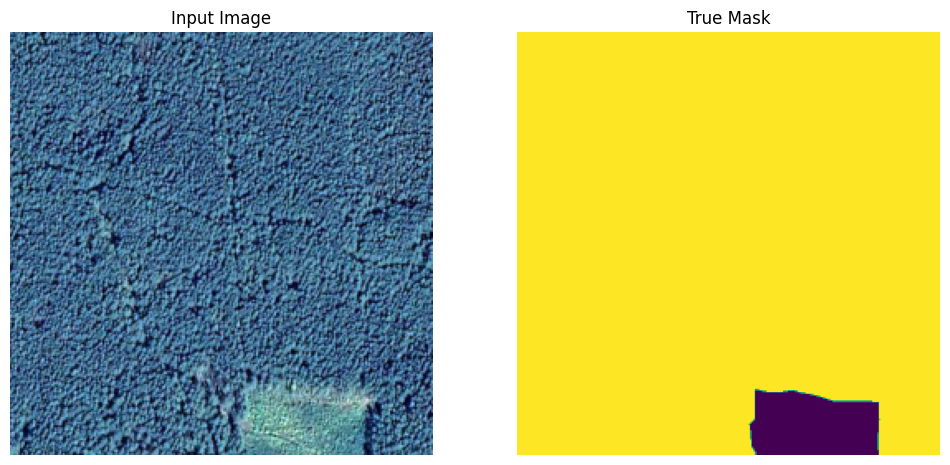

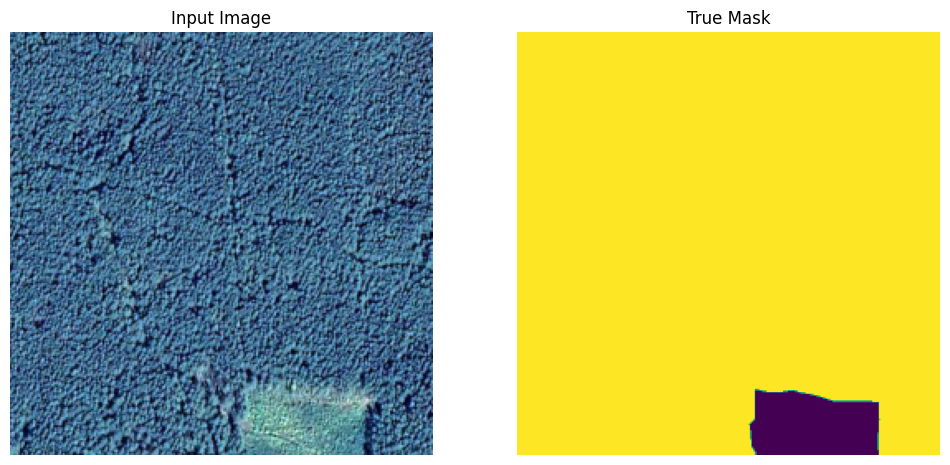

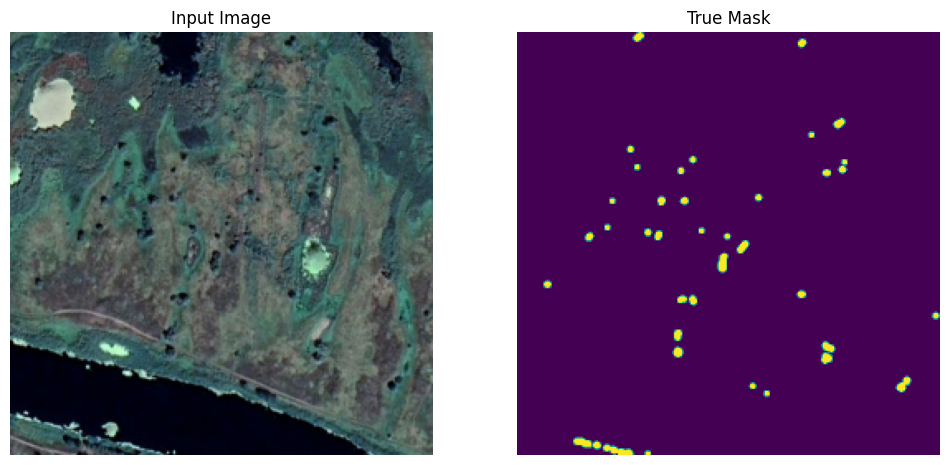

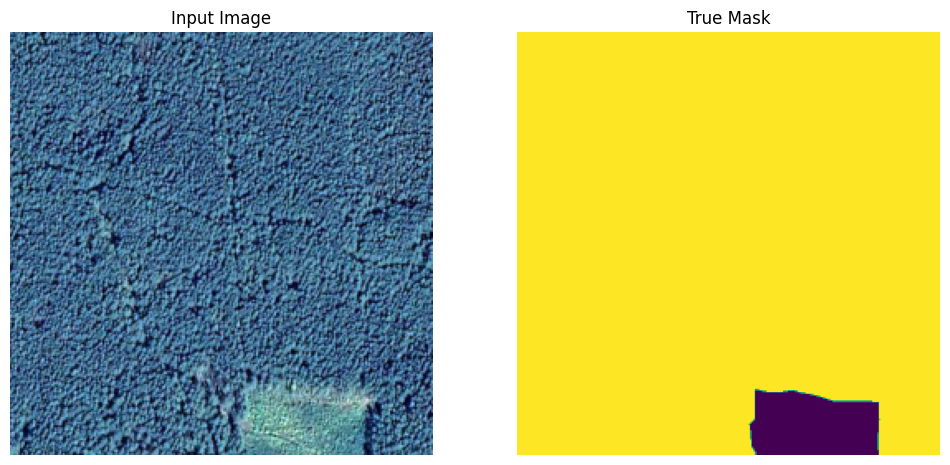

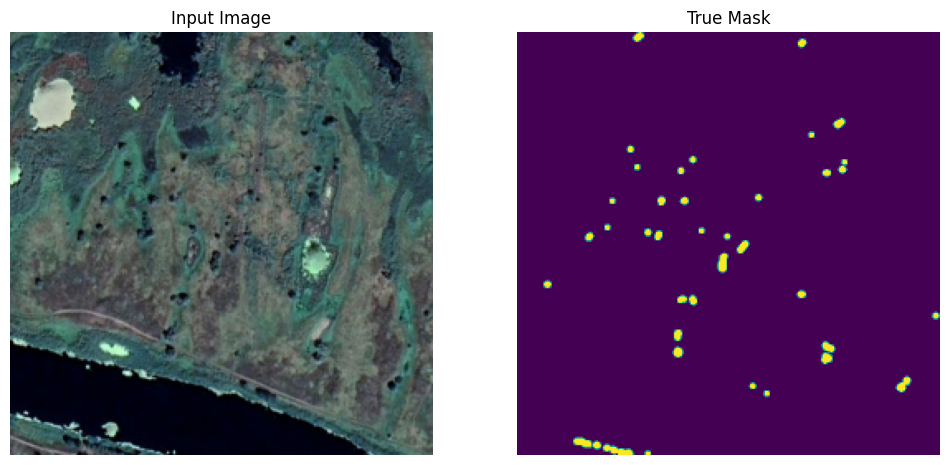

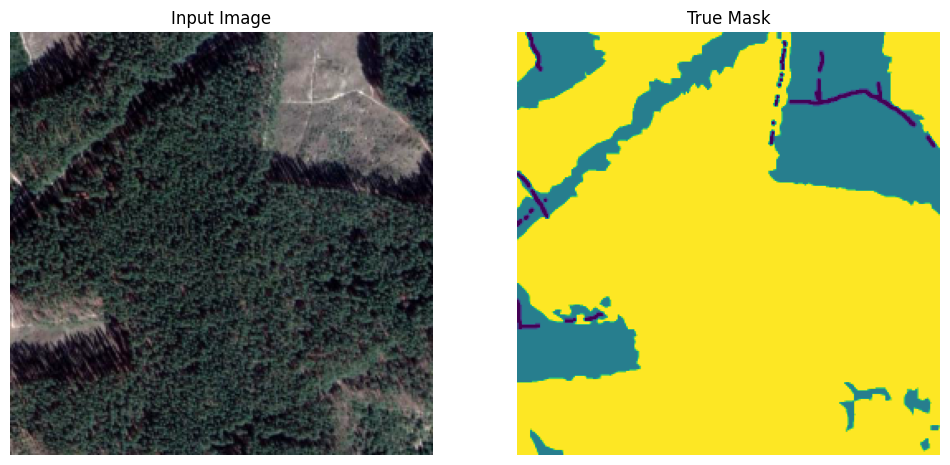

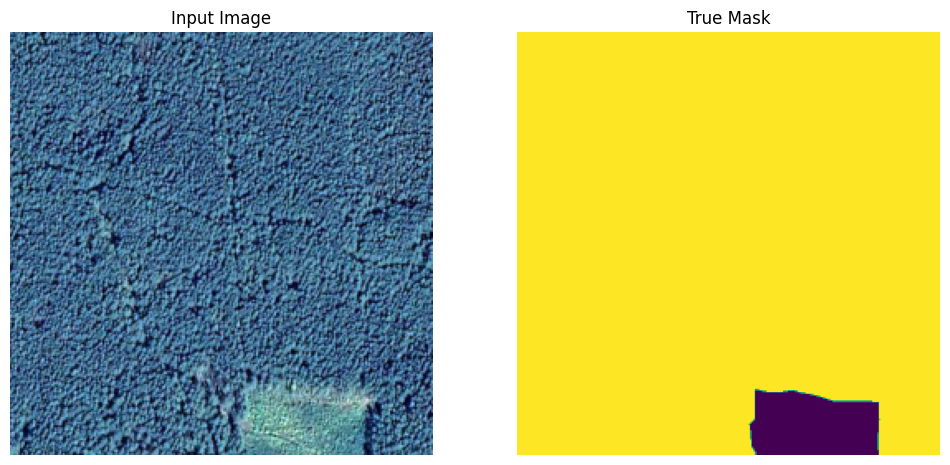

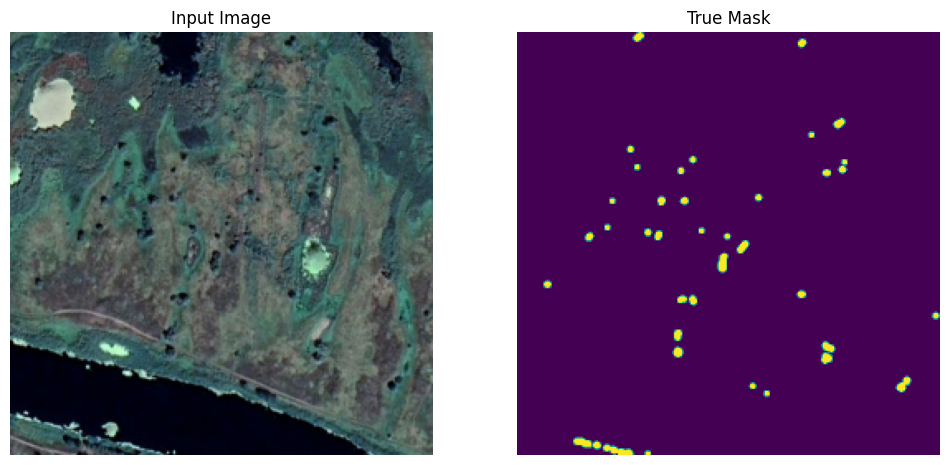

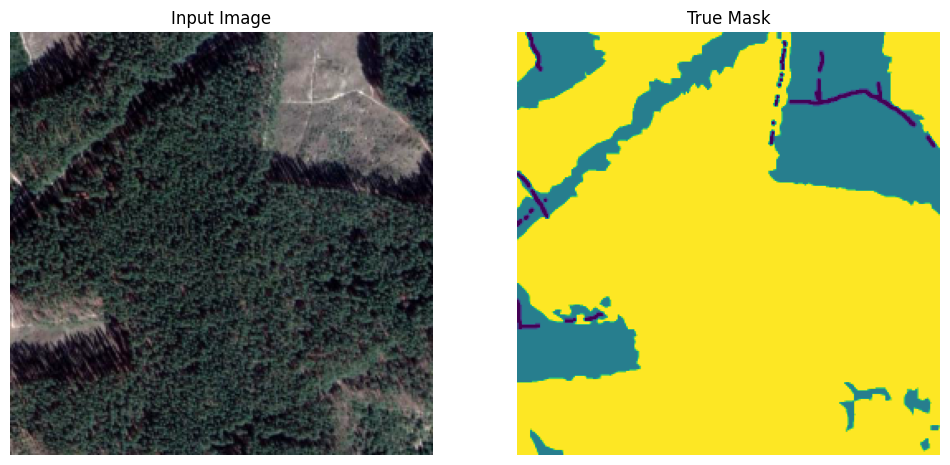

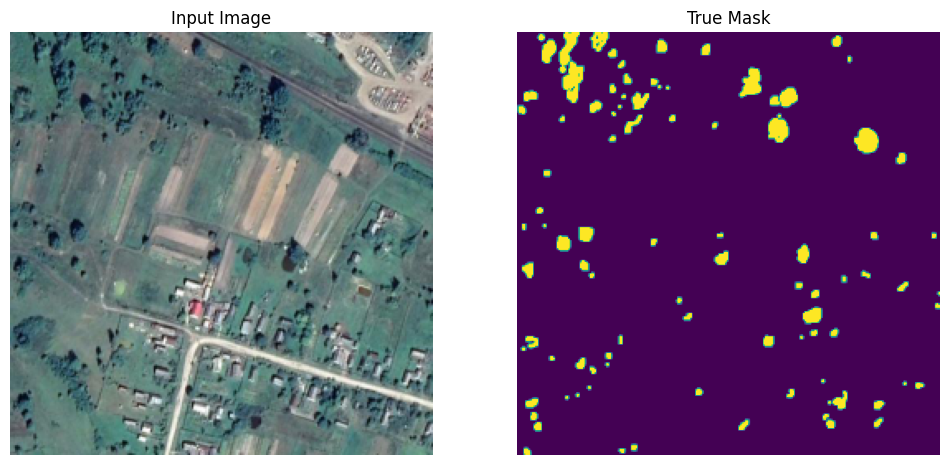

In [65]:
for i in range(5):
    for image, mask in train.take(i):
        sample_image, sample_mask = image, mask
        display([sample_image, sample_mask])


**Model**

We are going to use U-Net model. A U-Net consists of an encoder (downsampler) and decoder (upsampler). In-order to learn robust features, and reduce the number of trainable parameters, a pretrained model can be used as the encoder.The encoder will be a pretrained MobileNetV2 model which is prepared and ready to use in tf.keras.applications.

In [66]:
from tensorflow.keras.layers import Input
from tensorflow.keras.applications import MobileNetV2

input_tensor = Input(shape=(512, 512, 3))

# Load MobileNetV2 without the top layer, with the custom input tensor
base_model = MobileNetV2(input_tensor=input_tensor, include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)
down_stack.trainable = True 

/tmp/ipykernel_58890/107126612.py:7: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(input_tensor=input_tensor, include_top=False)


In [67]:
def upsample(filters, size, norm_type='batchnorm', apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    
    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    if norm_type.lower() == 'batchnorm':
        result.add(tf.keras.layers.BatchNormalization())
    elif norm_type.lower() == 'instancenorm':
        result.add(InstanceNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

        result.add(tf.keras.layers.ReLU())

    return result

up_stack = [
    upsample(512, 3),  # 4x4 -> 8x8
    upsample(256, 3),  # 8x8 -> 16x16
    upsample(128, 3),  # 16x16 -> 32x32
    upsample(64, 3),   # 32x32 -> 64x64
]

In [68]:
def unet_model(output_channels):
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

  # This is the last layer of the model
    last = tf.keras.layers.Conv2DTranspose(
      output_channels, 3, strides=2, activation='sigmoid',
      padding='same')  #64x64 -> 128x128

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

**Train the model**

Now let's compile the model and see the model architecture

Lets do some prediction before training

In [71]:
def dice_coef(y_true, y_pred, smooth=1):
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
    union = tf.reduce_sum(y_true, axis=[1,2,3]) + tf.reduce_sum(y_pred, axis=[1,2,3])
    return tf.reduce_mean((2. * intersection + smooth) / (union + smooth), axis=0)

def dice_loss(in_gt, in_pred):
    return 1 - dice_coef(in_gt, in_pred)


In [72]:
model.summary()

Model: "functional_13"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_9       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ functional_8        │ [(None, 128, 128, │  1,841,984 │ input_layer_9[0]… │
│ (Functional)        │ 96), (None, 64,   │            │                   │
│                     │ 64, 144), (None,  │            │                   │
│                     │ 32, 32, 192),     │            │                   │
│                     │ (None, 16, 16,    │            │                   │
│                     │ 576), (None, 8,   │            │                   │
│                     │ 8, 320)]          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_12       │ (None, 16, 16,    │  1,476,608 │ functional_8[0][… │
│ (Sequential)        │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_4       │ (None, 16, 16,    │          0 │ sequential_12[0]… │
│ (Concatenate)       │ 1088)             │            │ functional_8[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_13       │ (None, 32, 32,    │  2,507,776 │ concatenate_4[0]… │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_5       │ (None, 32, 32,    │          0 │ sequential_13[0]… │
│ (Concatenate)       │ 448)              │            │ functional_8[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_14       │ (None, 64, 64,    │    516,608 │ concatenate_5[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_6       │ (None, 64, 64,    │          0 │ sequential_14[0]… │
│ (Concatenate)       │ 272)              │            │ functional_8[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_15       │ (None, 128, 128,  │    156,928 │ concatenate_6[0]… │
│ (Sequential)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_7       │ (None, 128, 128,  │          0 │ sequential_15[0]… │
│ (Concatenate)       │ 160)              │            │ functional_8[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_17 │ (None, 256, 256,  │      1,441 │ concatenate_7[0]… │
│ (Conv2DTranspose)   │ 1)                │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 6,501,345 (24.80 MB)

 Trainable params: 6,468,513 (24.68 MB)

 Non-trainable params: 32,832 (128.25 KB)

In [73]:
def visualize(display_list):
    plt.figure(figsize=(12,12))
    title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

def show_predictions(sample_image, sample_mask):
    pred_mask = model.predict(sample_image[tf.newaxis, ...])
    pred_mask = pred_mask.reshape(img_size[0],img_size[1],1)
    visualize([sample_image, sample_mask, pred_mask])

2024-10-24 16:28:46.433102: W tensorflow/core/kernels/data/cache_dataset_ops.cc:913] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.
/home/luci/.local/lib/python3.10/site-packages/keras/src/models/functional.py:225: UserWarning: The structure of `inputs` doesn't match the expected structure: ['keras_tensor_489']. Received: the structure of inputs=*
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step


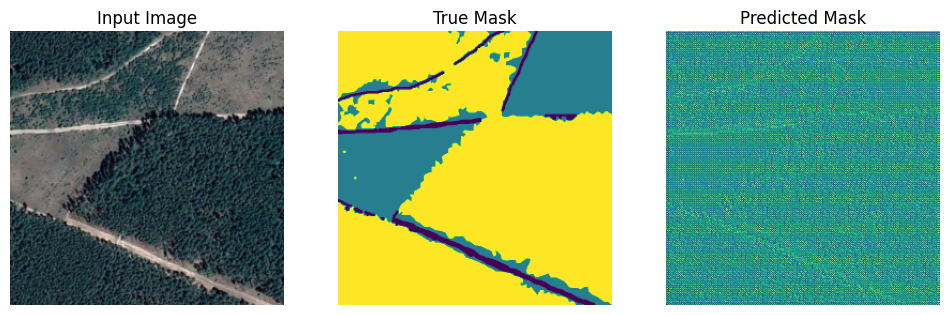

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


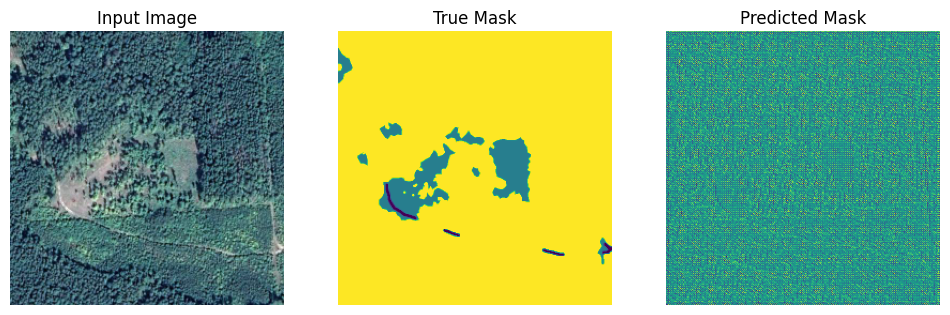

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


2024-10-24 16:28:47.623017: W tensorflow/core/kernels/data/cache_dataset_ops.cc:913] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


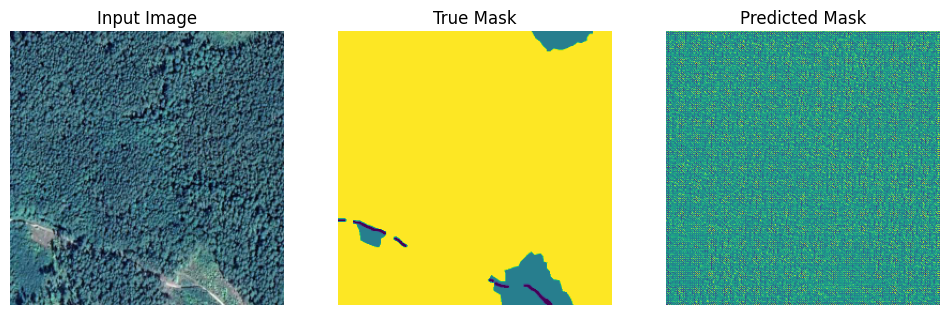

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


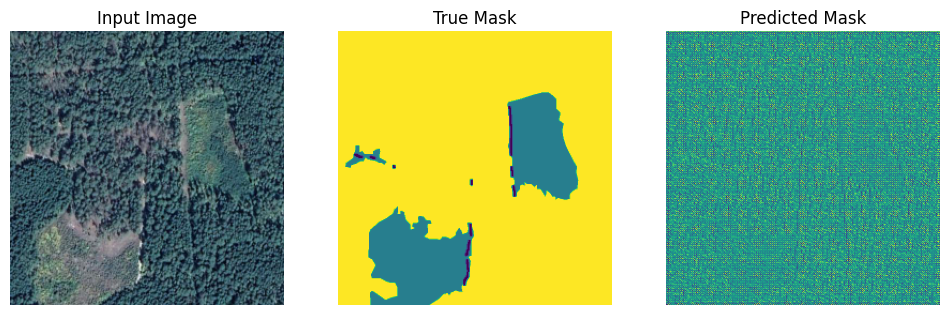

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


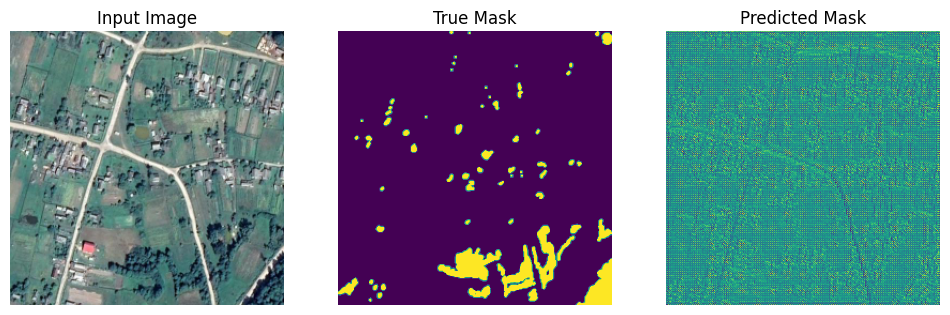

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


2024-10-24 16:28:48.485863: W tensorflow/core/kernels/data/cache_dataset_ops.cc:913] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


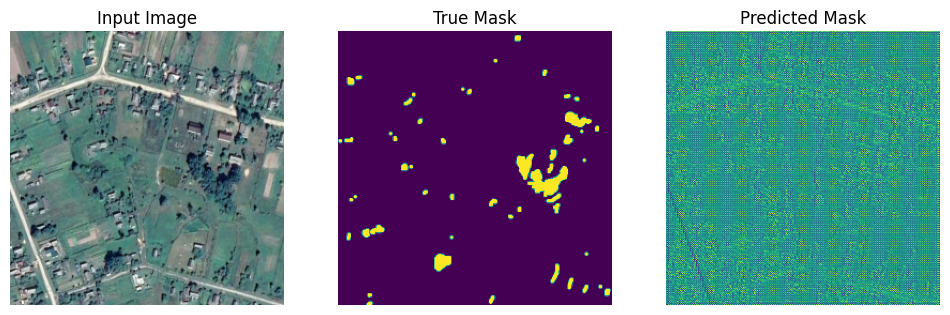

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


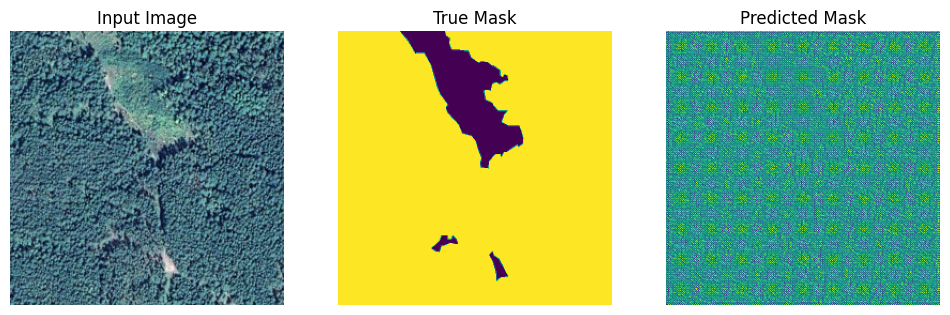

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


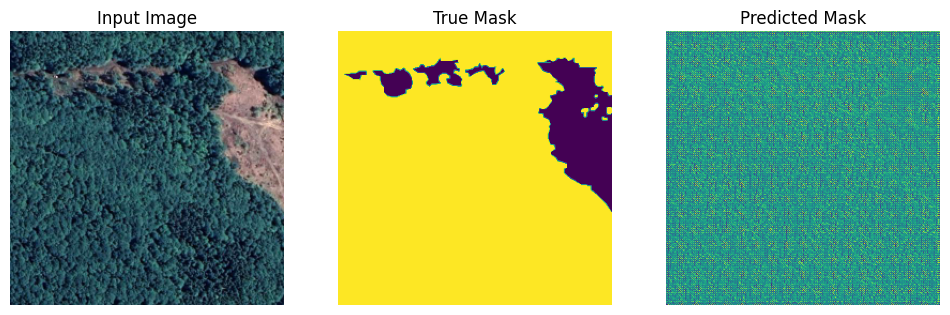

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


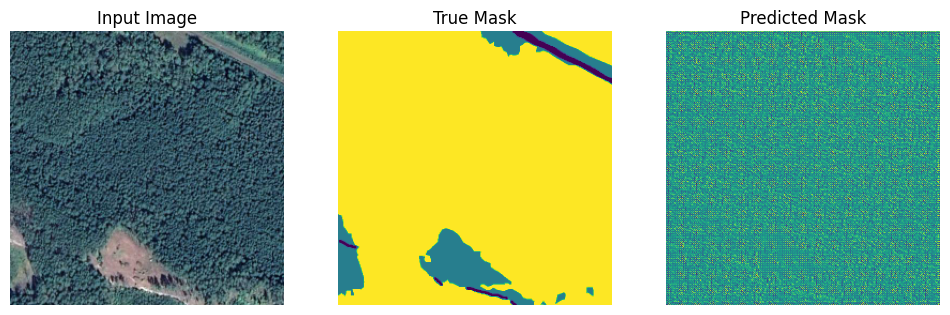

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


2024-10-24 16:28:49.782357: W tensorflow/core/kernels/data/cache_dataset_ops.cc:913] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


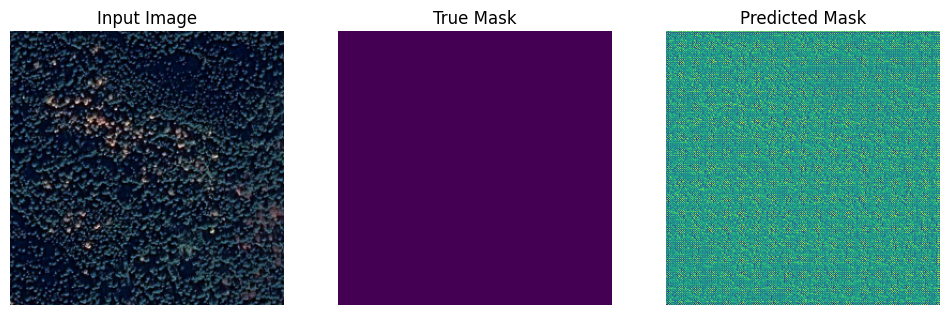

In [74]:
for i in range(5):
    for images, masks in train_dataset.take(i):
        for img, mask in zip(images, masks):
            sample_image = img
            sample_mask = mask
            show_predictions(sample_image, sample_mask)
            break

In [75]:
def dice_coef(y_true, y_pred, smooth=1):
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
    union = tf.reduce_sum(y_true, axis=[1,2,3]) + tf.reduce_sum(y_pred, axis=[1,2,3])
    return tf.reduce_mean((2. * intersection + smooth) / (union + smooth), axis=0)

def dice_loss(in_gt, in_pred):
    return 1 - dice_coef(in_gt, in_pred)


Epoch 1/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 42s 930ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5455 - loss: 0.4545
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 163ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0255 - loss: 0.9741
Epoch 2/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 27s 834ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6001 - loss: 0.3999
9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 149ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.1498 - loss: 0.8479
Epoch 3/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 30s 945ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6058 - loss: 0.3942
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 161ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0187 - loss: 0.9811
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


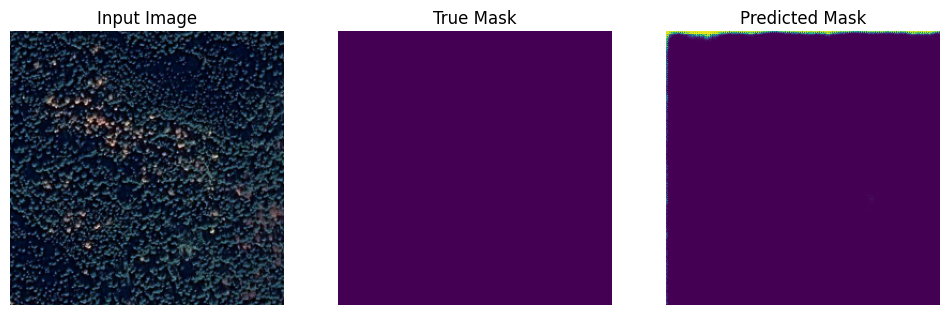

Epoch 4/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 897ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6029 - loss: 0.3971
9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 148ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0068 - loss: 0.9931
Epoch 5/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 870ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6003 - loss: 0.3997
9/9 ━━━━━━━━━━━━━━━━━━━━ 4s 354ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0533 - loss: 0.9461
Epoch 6/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 892ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6072 - loss: 0.3928
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0114 - loss: 0.9885
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


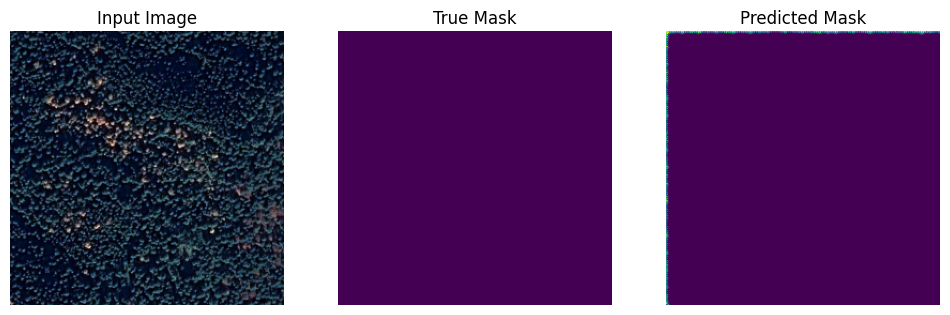

Epoch 7/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 875ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5964 - loss: 0.4036
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 212ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0053 - loss: 0.9946
Epoch 8/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 898ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5960 - loss: 0.4040
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 194ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0015 - loss: 0.9985
Epoch 9/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 880ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5939 - loss: 0.4061
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 6.6790e-04 - loss: 0.9993
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


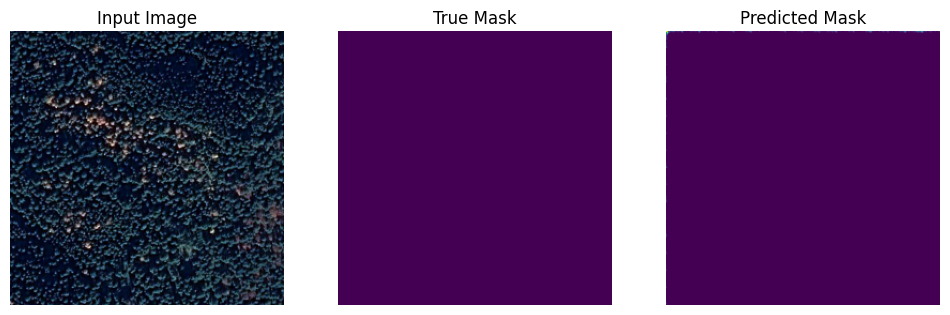

Epoch 10/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 880ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5992 - loss: 0.4008
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 203ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0011 - loss: 0.9989
Epoch 11/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 879ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5942 - loss: 0.4058
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 200ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 2.2322e-04 - loss: 0.9998
Epoch 12/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 910ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6061 - loss: 0.3939
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 204ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 1.7186e-04 - loss: 0.9998
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


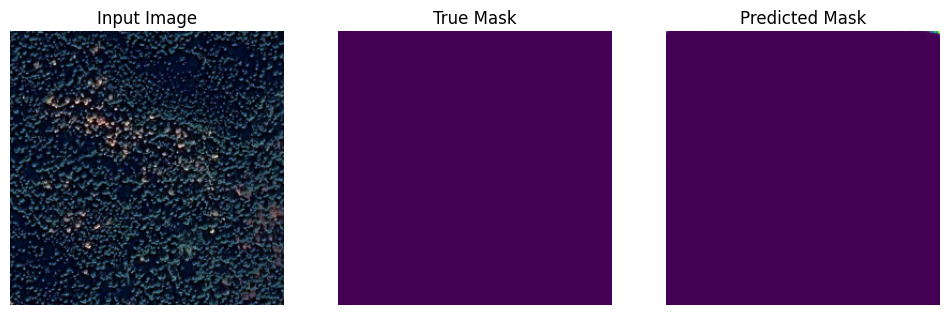

Epoch 13/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 30s 923ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6067 - loss: 0.3933
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 194ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 1.0058e-04 - loss: 0.9999
Epoch 14/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 879ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5906 - loss: 0.4094
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 194ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0470 - loss: 0.9519
Epoch 15/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 879ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6071 - loss: 0.3929
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 196ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0772 - loss: 0.9211
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


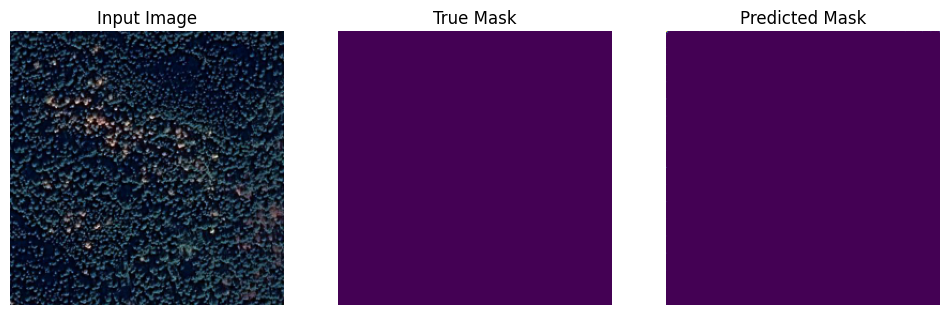

Epoch 16/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 878ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6037 - loss: 0.3963
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0078 - loss: 0.9921
Epoch 17/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 876ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6050 - loss: 0.3950
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 3.6089e-05 - loss: 1.0000
Epoch 18/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 889ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5992 - loss: 0.4008
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 195ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 3.9400e-05 - loss: 1.0000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


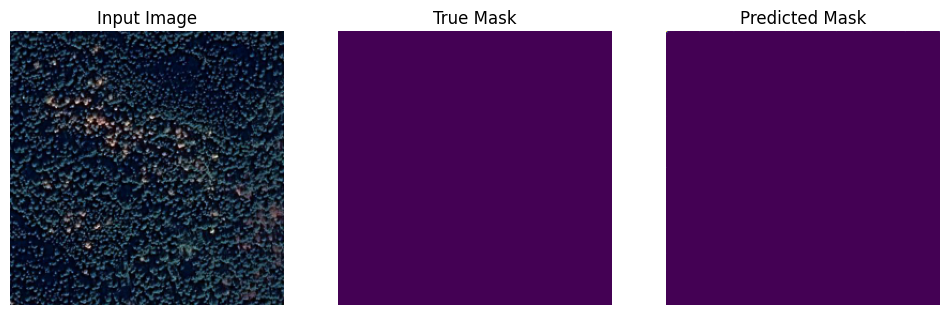

Epoch 19/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 898ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6085 - loss: 0.3915
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 201ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0025 - loss: 0.9974
Epoch 20/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 879ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6104 - loss: 0.3896
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0321 - loss: 0.9673
Epoch 21/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 880ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6072 - loss: 0.3928
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0269 - loss: 0.9724
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


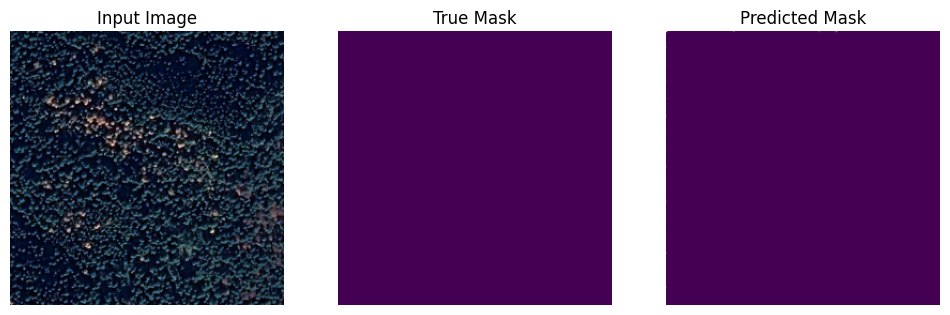

Epoch 22/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 885ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5982 - loss: 0.4018
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 191ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0395 - loss: 0.9595
Epoch 23/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 879ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6016 - loss: 0.3984
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 212ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0019 - loss: 0.9980   
Epoch 24/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 895ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6033 - loss: 0.3967
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0695 - loss: 0.9290
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


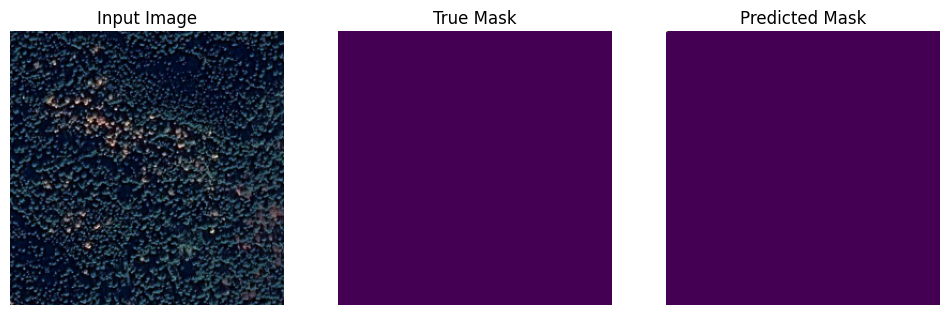

Epoch 25/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 884ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6040 - loss: 0.3960
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 196ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0854 - loss: 0.9126
Epoch 26/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 887ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6069 - loss: 0.3931
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 192ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.0930 - loss: 0.9054
Epoch 27/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 875ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6007 - loss: 0.3993
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 208ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.1619 - loss: 0.8364
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


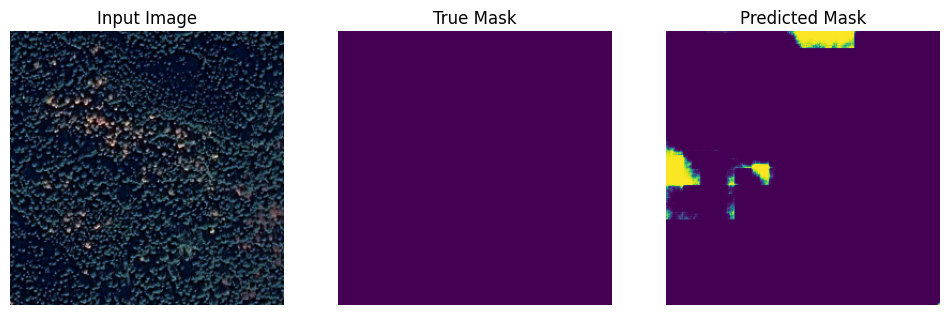

Epoch 28/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 874ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6123 - loss: 0.3877
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 192ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.2503 - loss: 0.7486
Epoch 29/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 877ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6034 - loss: 0.3966
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 191ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.4858 - loss: 0.5173
Epoch 30/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 879ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6009 - loss: 0.3991
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 191ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.4253 - loss: 0.5789
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


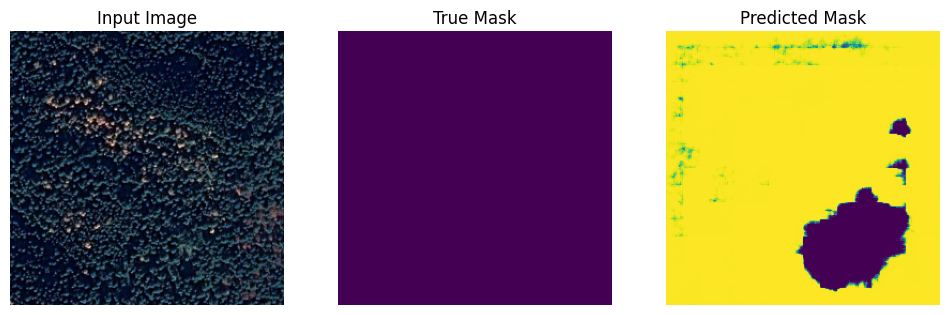

Epoch 31/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 876ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6019 - loss: 0.3981
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 189ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.4727 - loss: 0.5292
Epoch 32/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 881ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6071 - loss: 0.3929
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 192ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5235 - loss: 0.4779
Epoch 33/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 875ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6068 - loss: 0.3932
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 193ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5671 - loss: 0.4337
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


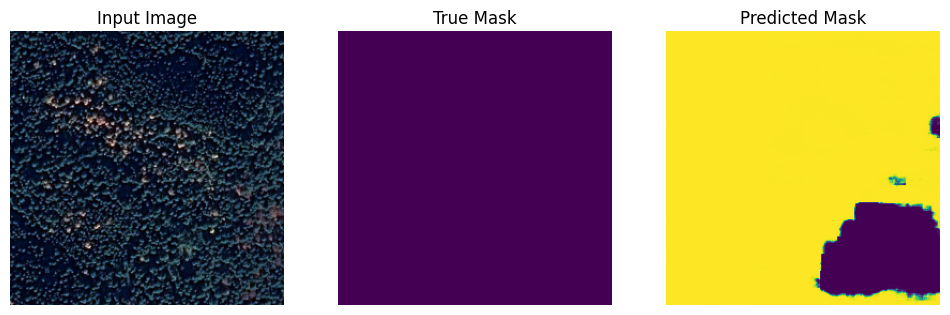

Epoch 34/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 875ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5928 - loss: 0.4072
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 194ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5646 - loss: 0.4358
Epoch 35/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 873ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5959 - loss: 0.4041
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 192ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5610 - loss: 0.4394
Epoch 36/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 30s 943ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6023 - loss: 0.3977
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 228ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5627 - loss: 0.4382
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


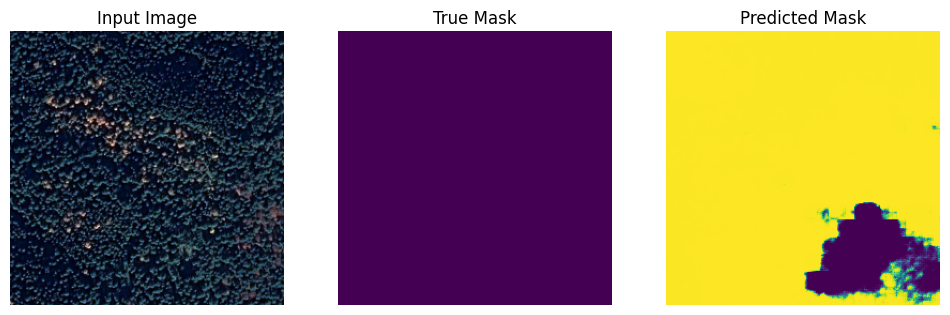

Epoch 37/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 919ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6063 - loss: 0.3937
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 194ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5571 - loss: 0.4431
Epoch 38/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 29s 904ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6047 - loss: 0.3953
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 201ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5865 - loss: 0.4143
Epoch 39/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 30s 951ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.6061 - loss: 0.3939
9/9 ━━━━━━━━━━━━━━━━━━━━ 2s 199ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5362 - loss: 0.4636
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


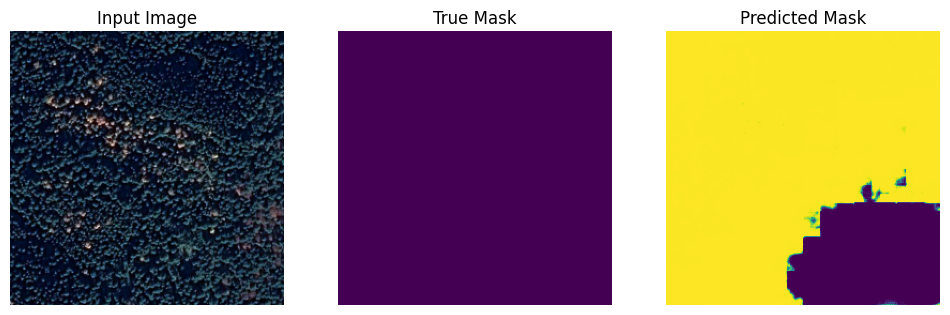

Epoch 40/40
32/32 ━━━━━━━━━━━━━━━━━━━━ 30s 918ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5988 - loss: 0.4012
9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 160ms/step - binary_accuracy: 0.0000e+00 - dice_coef: 0.5941 - loss: 0.4061


In [76]:
EPOCHS = 40
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE
patience = 4
best_weights = None
best_val_loss = float('inf')
wait = 0

for epoch in range(EPOCHS):
    print(f"Epoch {epoch + 1}/{EPOCHS}")

    # Train for one epoch
    model.fit(train_dataset, epochs=1, steps_per_epoch=STEPS_PER_EPOCH)

    # Validation loss
    val_loss = model.evaluate(valid_dataset)


    # Display predictions after every 3 epochs
    if (epoch + 1) % 3 == 0:
        show_predictions(sample_image, sample_mask)


**Testing**

We test the trained model on our test dataset

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


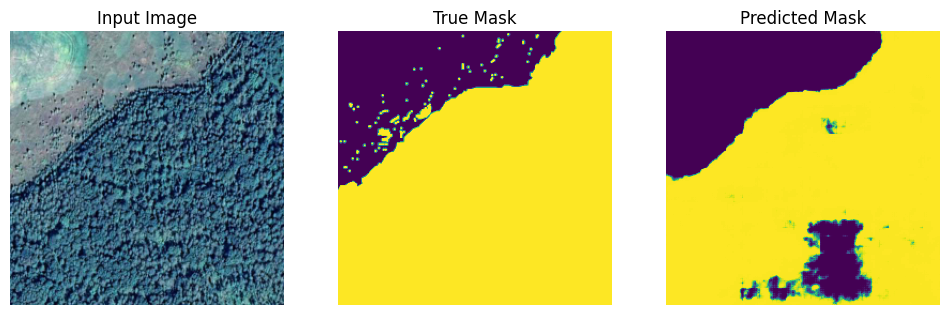

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


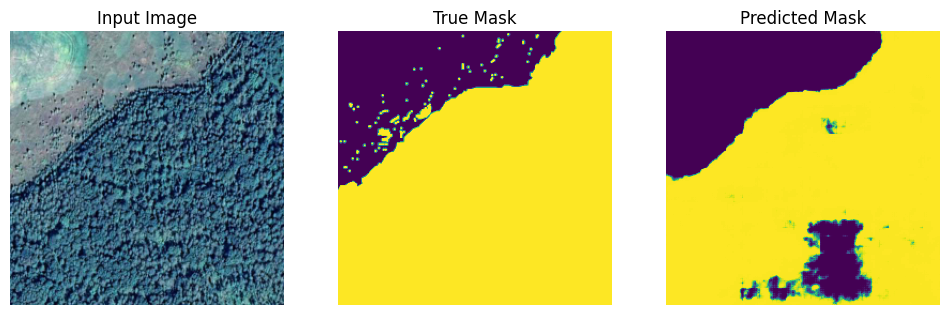

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


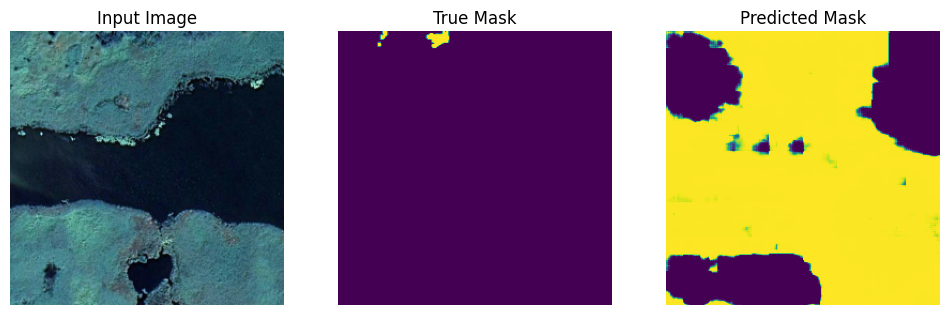

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


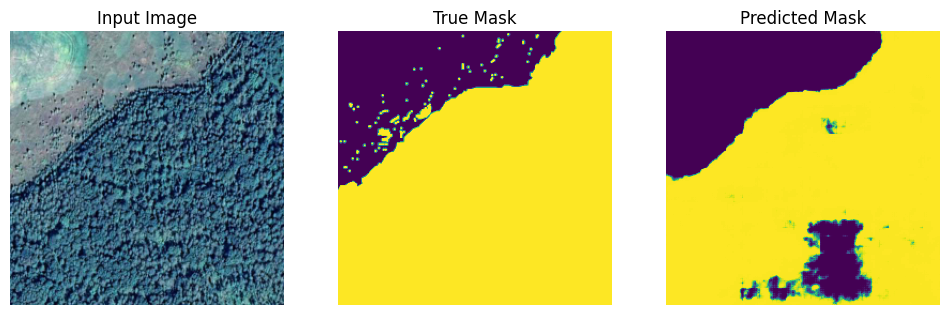

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


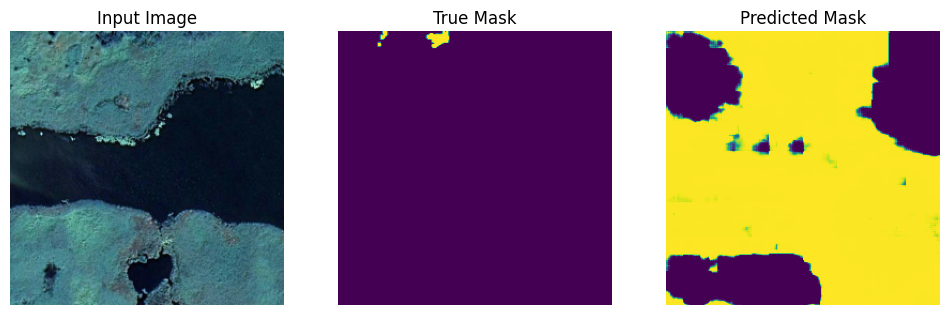

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


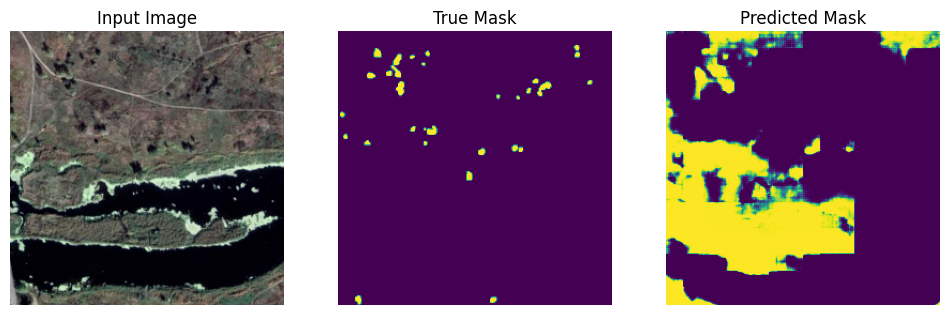

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


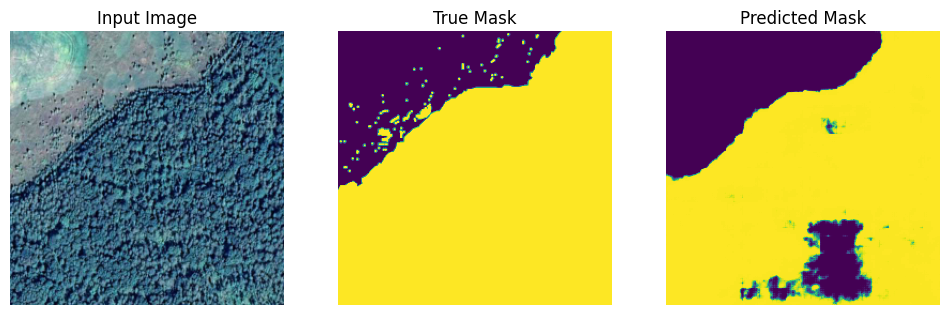

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


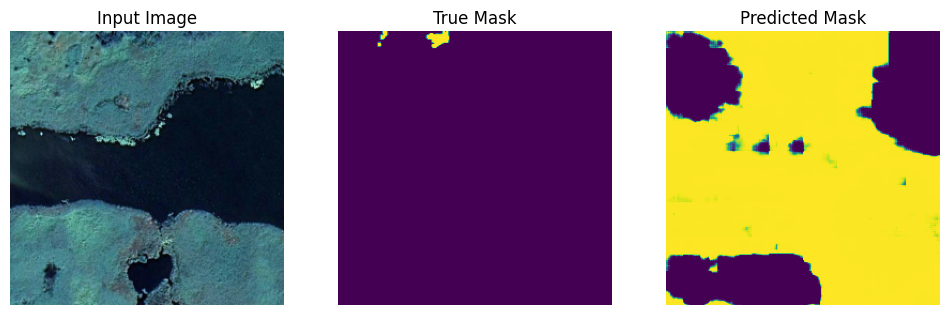

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


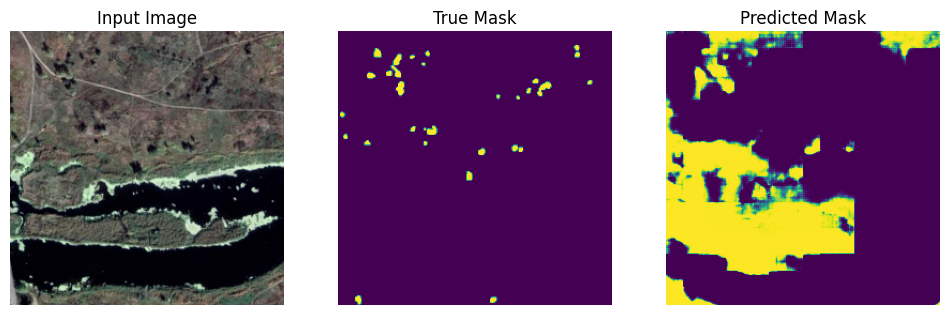

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


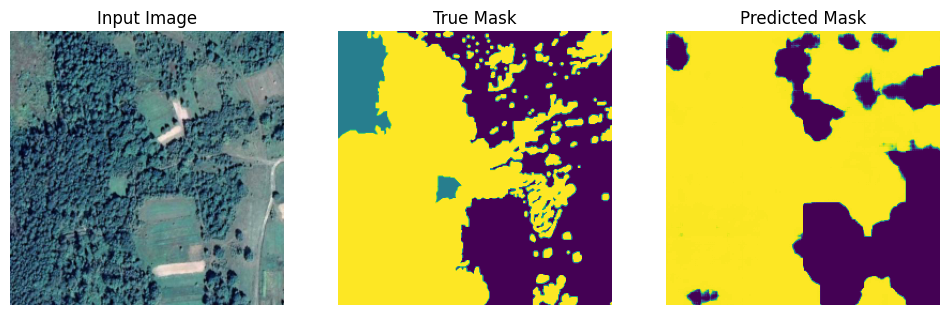

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


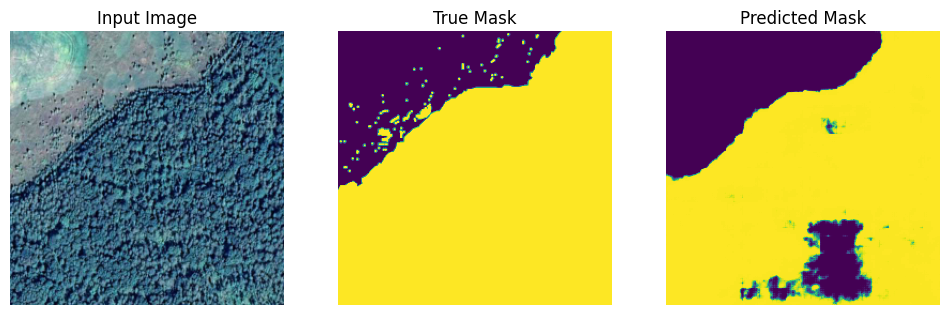

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


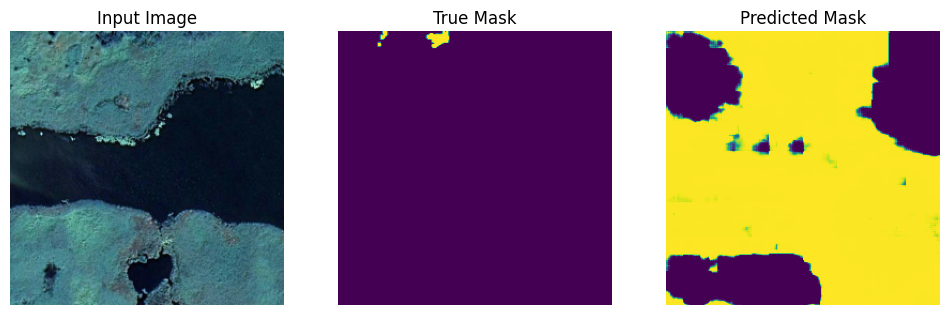

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


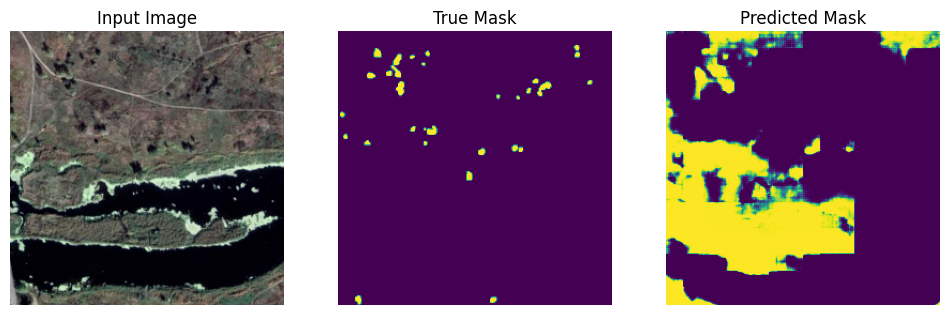

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


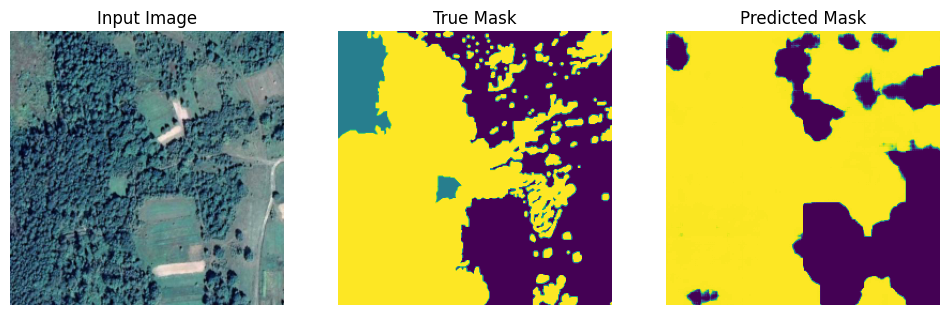

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


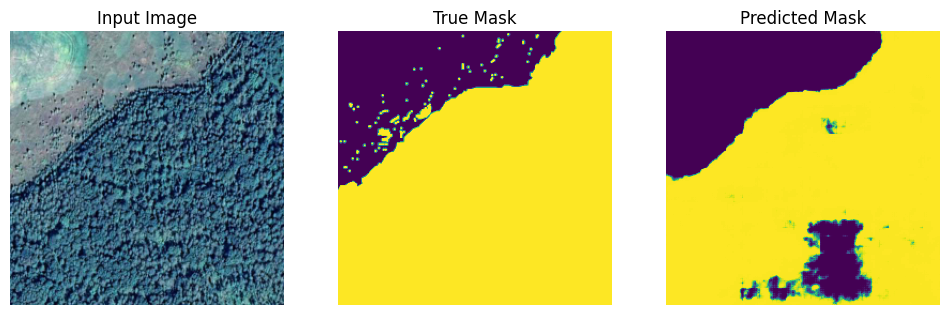

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


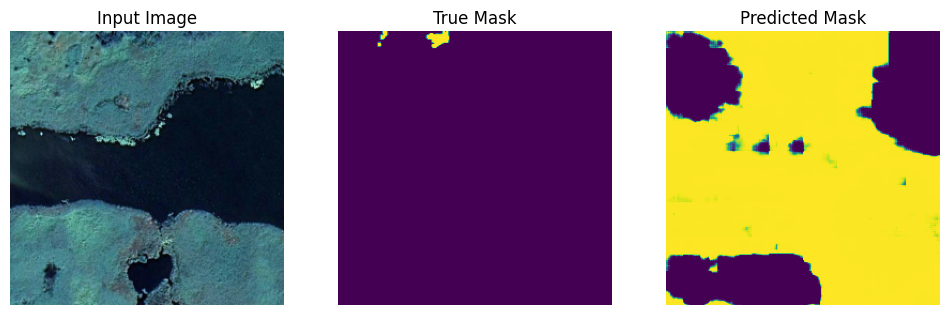

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


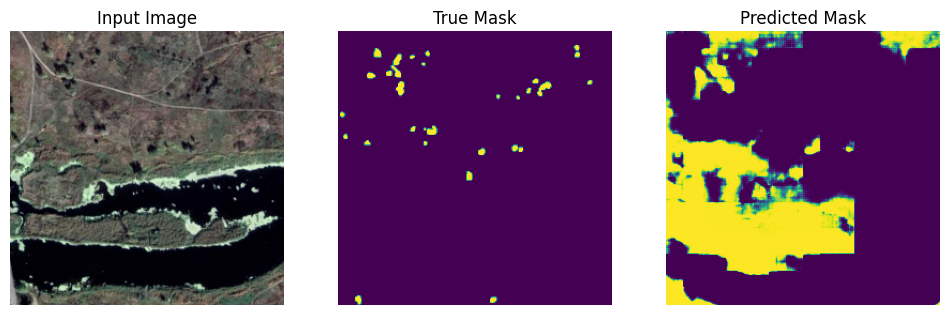

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


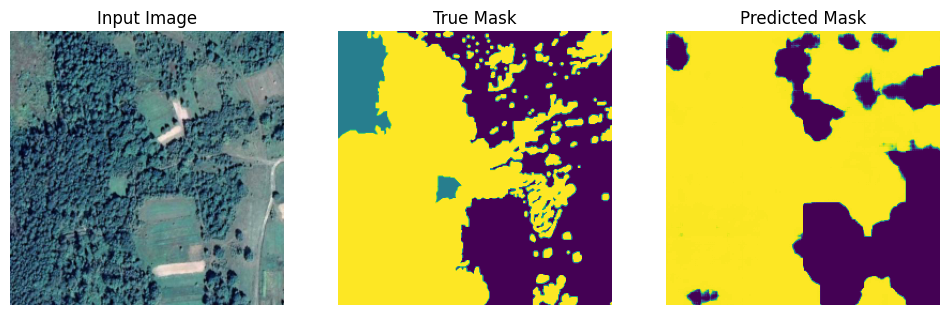

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


2024-10-24 16:49:26.135641: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


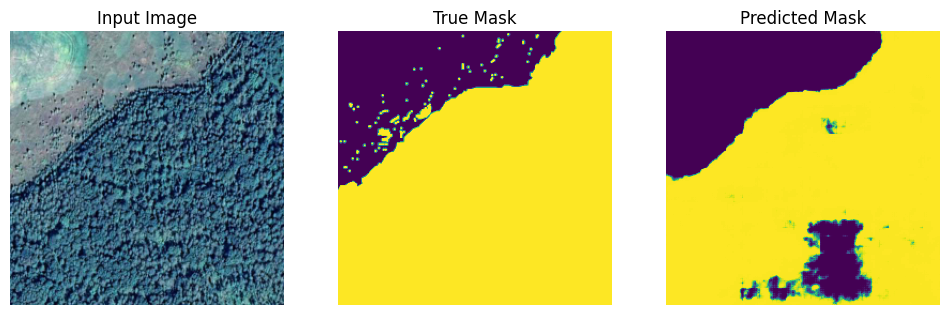

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


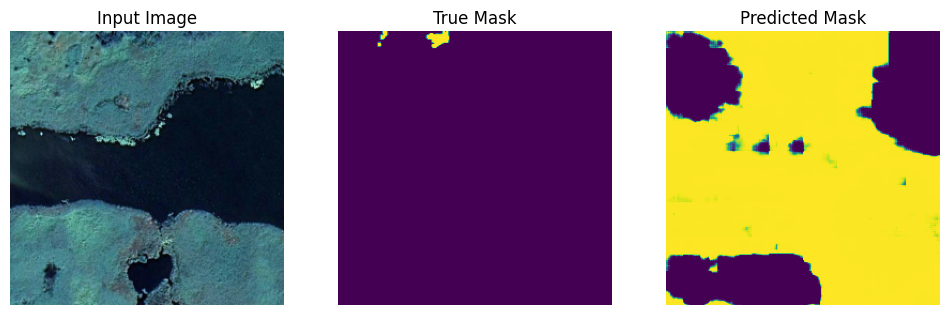

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


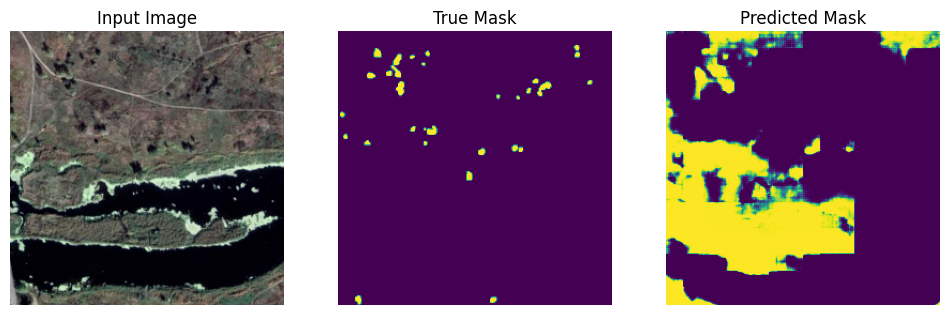

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


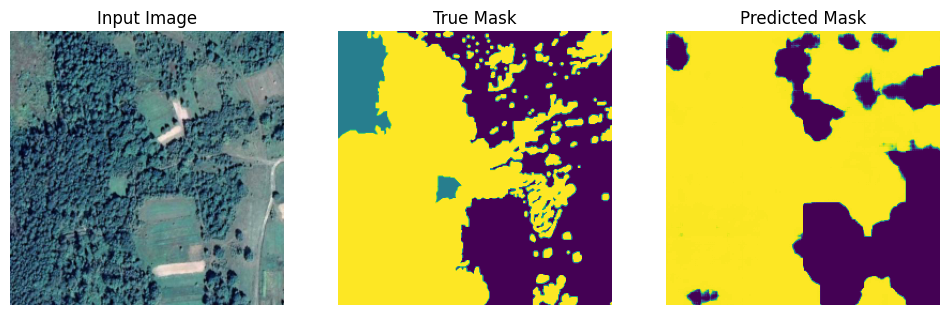

In [77]:
for i in range(8):
    for images, masks in test_dataset.take(i):
        for img, mask in zip(images, masks):
            tsample_image = img
            tsample_mask = mask
            show_predictions(tsample_image, tsample_mask)
            break

**Evaluation**



In [79]:
def plot_accuracy_loss(model_history):
    """
        Plot the accuracy and the loss during the training of the nn.
    """
    fig = plt.figure(figsize=(10,5))

    # Plot accuracy
    plt.subplot(221)
    plt.plot(model_history.history['binary_accuracy'],'bo--', label = "acc")
    plt.plot(model_history.history['val_binary_accuracy'], 'ro--', label = "val_acc")
    plt.title("train_acc vs val_acc")
    plt.ylabel("accuracy")
    plt.xlabel("epochs")
    plt.legend()

    # Plot loss function
    plt.subplot(222)
    plt.plot(model_history.history['loss'],'bo--', label = "loss")
    plt.plot(model_history.history['val_loss'], 'ro--', label = "val_loss")
    plt.title("train_loss vs val_loss")
    plt.ylabel("loss")
    plt.xlabel("epochs")

    plt.legend()
    plt.show()

In [80]:
plot_accuracy_loss(model_history)

NameError: name 'model_history' is not defined

**Acknowledgements**

https://www.kaggle.com/code/dikshabhati2002/image-segmentation-u-net/notebook